# DETR multihead visualization

In [53]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

1.5.0 True


In [54]:
from util.plot_utils import *
from pathlib import Path, PurePath
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%config InlineBackend.figure_format = 'retina'
import torchvision.transforms as T
import requests
from PIL import Image
torch.set_grad_enabled(False);

In [55]:
import argparse
from models import build_model

## Inference

Define args to instantiate model:

In [56]:
def get_args_parser():
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--lr', default=1e-4, type=float)
    parser.add_argument('--lr_backbone', default=1e-5, type=float)
    parser.add_argument('--batch_size', default=2, type=int)
    parser.add_argument('--weight_decay', default=1e-4, type=float)
    parser.add_argument('--epochs', default=300, type=int)
    parser.add_argument('--lr_drop', default=200, type=int)
    parser.add_argument('--clip_max_norm', default=0.1, type=float,
                        help='gradient clipping max norm')

    # Model parameters
    parser.add_argument('--num_classes', type=int, default=21,
                        help="Number of classes in dataset+1")
    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")

    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer")
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=100, type=int,
                        help="Number of query slots")
    # Loss
    parser.add_argument('--no_aux_loss', dest='aux_loss', action='store_false',
                        help="Disables auxiliary decoding losses (loss at each layer)")
    # * Matcher
    parser.add_argument('--set_cost_class', default=1, type=float,
                        help="Class coefficient in the matching cost")
    parser.add_argument('--set_cost_bbox', default=5, type=float,
                        help="L1 box coefficient in the matching cost")
    parser.add_argument('--set_cost_giou', default=2, type=float,
                        help="giou box coefficient in the matching cost")
    # * Loss coefficients
    parser.add_argument('--bbox_loss_coef', default=5, type=float)
    parser.add_argument('--giou_loss_coef', default=2, type=float)
    parser.add_argument('--eos_coef', default=0.1, type=float,
                        help="Relative classification weight of the no-object class")

    # dataset parameters
    parser.add_argument('--dataset_file', default='coco')
    parser.add_argument('--coco_path', type=str)

    parser.add_argument('--output_dir', default='',
                        help='path where to save, empty for no saving')
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    parser.add_argument('--seed', default=42, type=int)
    parser.add_argument('--resume', default='', help='resume from checkpoint')
    parser.add_argument('--start_epoch', default=0, type=int, metavar='N',
                        help='start epoch')
    parser.add_argument('--eval', action='store_true')
    parser.add_argument('--num_workers', default=2, type=int)

    return parser

In [57]:
parser = argparse.ArgumentParser('DETR evaluation and inference script', parents=[get_args_parser()])
args = parser.parse_args("")

In [58]:
args.aux_loss = False
# args.coco_path = '..\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12'
args.eval = True
# args.resume = 'output\Pascal_VOC\dgx-lr_drop\checkpoint.pth'
args.num_classes = 91

In [59]:
print(args)

Namespace(aux_loss=False, backbone='resnet50', batch_size=2, bbox_loss_coef=5, clip_max_norm=0.1, coco_path=None, dataset_file='coco', dec_layers=6, device='cuda', dilation=False, dim_feedforward=2048, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=300, eval=True, giou_loss_coef=2, hidden_dim=256, lr=0.0001, lr_backbone=1e-05, lr_drop=200, nheads=8, num_classes=91, num_queries=100, num_workers=2, output_dir='', position_embedding='sine', resume='', seed=42, set_cost_bbox=5, set_cost_class=1, set_cost_giou=2, start_epoch=0, weight_decay=0.0001)


### Build model & load weights

In [60]:
model, _, _ = build_model(args)

checkpoint = torch.hub.load_state_dict_from_url(
            url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
            map_location='cpu',
            check_hash=True)
model.load_state_dict(checkpoint['model'])
model.eval();

Building a DETR model with 91 classes


### Utils to display inference results

Define classes and colors to display boxes:

In [61]:
# COCO classes
CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]

COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

DETR uses standard ImageNet normalization, and output boxes in relative image coordinates in $[x_{\text{center}}, y_{\text{center}}, w, h]$ format, where $[x_{\text{center}}, y_{\text{center}}]$ is the predicted center of the bounding box, and $w, h$ its width and height. 

Because the coordinates are relative to the image dimension and lies between $[0, 1]$, we convert predictions to absolute image coordinates and $[x_0, y_0, x_1, y_1]$ format for visualization purposes.

In [62]:
# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

Wrap input preparation, inference and output postprocessing in a single function:

In [63]:
def detect(im, model, transform, threshold):
    # mean-std normalize the input image (batch-size: 1)
    # makes a tensor of images containing a single image
    img = transform(im).unsqueeze(0)

    # demo model only support by default images with aspect ratio between 0.5 and 2
    # if you want to use images with an aspect ratio outside this range
    # rescale your image so that the maximum size is at most 1333 for best results
#     assert img.shape[-2] <= 1600 and img.shape[-1] <= 1600, 'demo model only supports images up to 1600 pixels on each side'

    # propagate through the model
    outputs = model(img)

    # keep only predictions with 0.7+ confidence
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > threshold

    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
    return probas[keep], bboxes_scaled

Function to display result:

In [64]:
def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), COLORS * 100):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [65]:
def plot_image(pil_img):
    plt.figure(figsize=(16,10))
    plt.axis('off')
    plt.imshow(pil_img)

### Inference example

Load and display initial image:

im:  (640, 480)


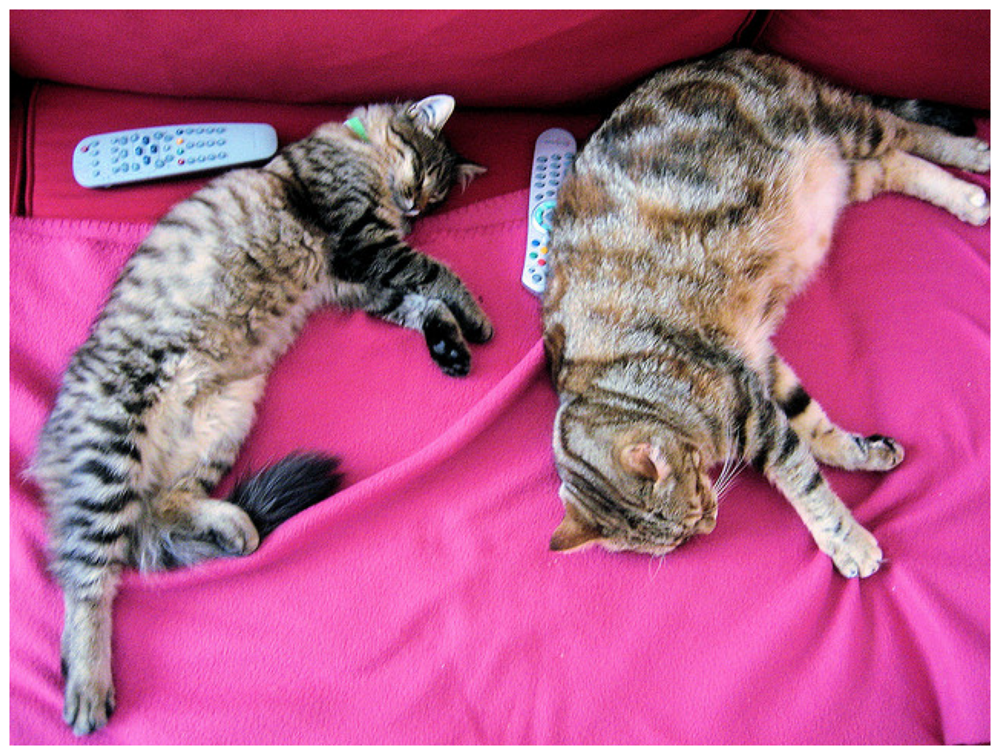

In [19]:
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

plot_image(im)

Run the image through the model and then display result:

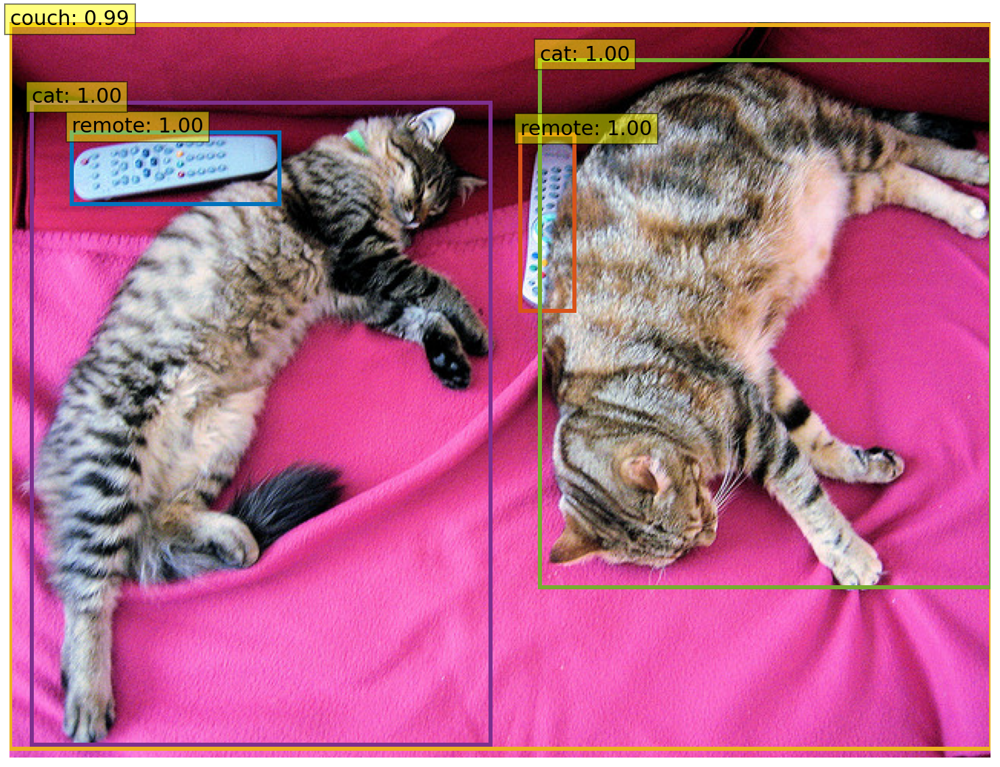

In [20]:
scores, boxes = detect(im, model, transform, 0.7)
plot_results(im, scores, boxes)

#### Inference on COCO dataset images

im:  (480, 640)


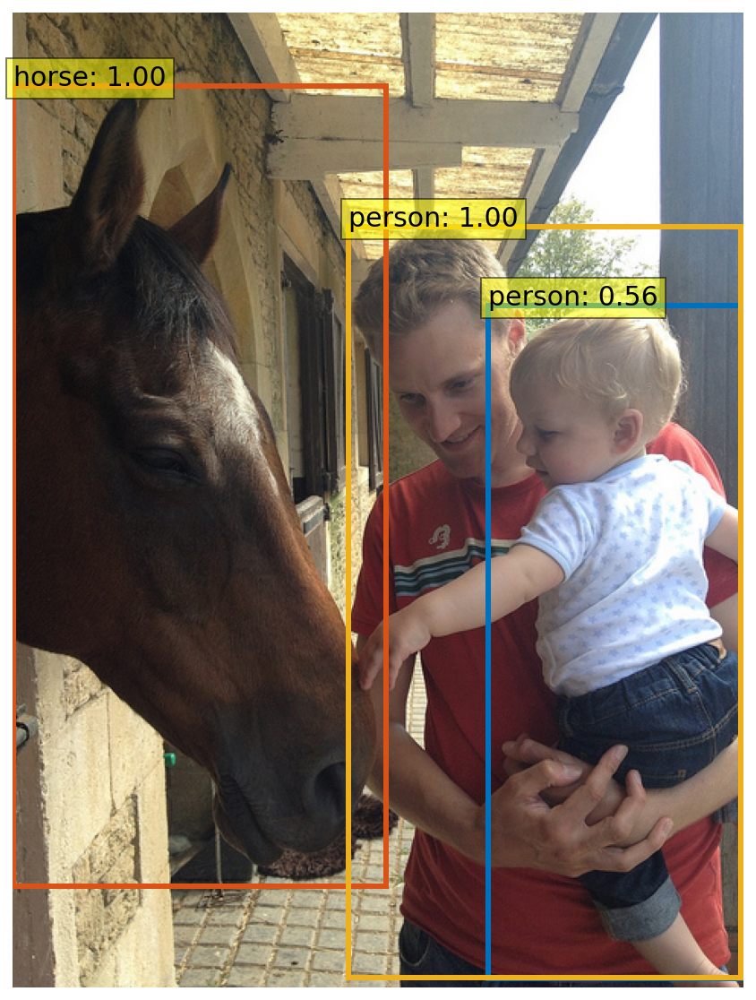

In [21]:
url = 'http://images.cocodataset.org/val2017/000000012748.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.5)
plot_results(im, scores, boxes)

im:  (640, 427)


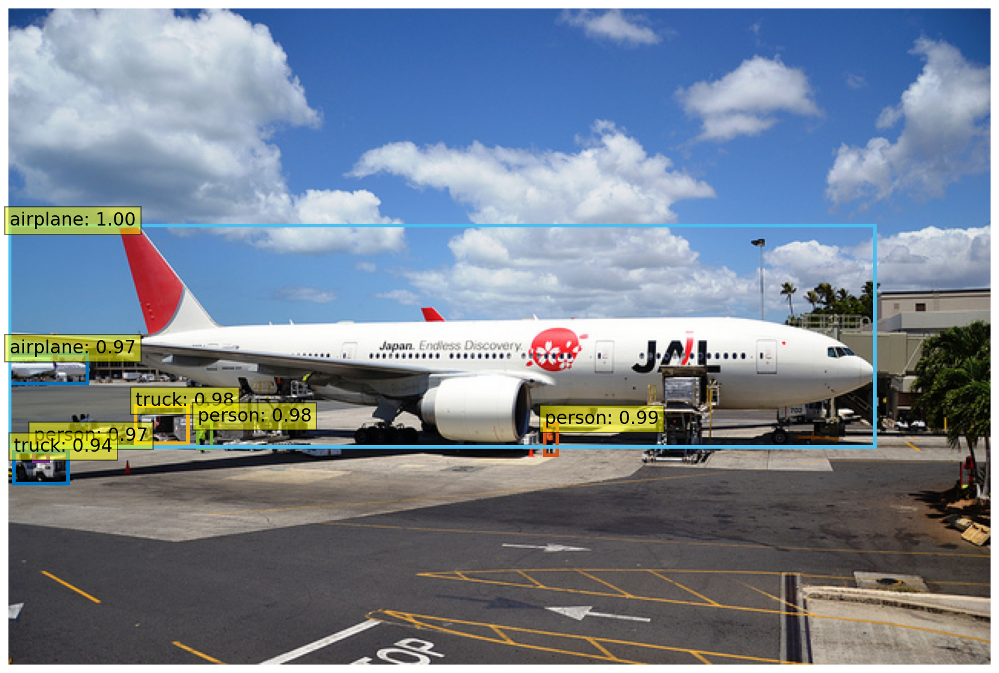

In [24]:
url = 'http://images.cocodataset.org/val2017/000000013348.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (640, 426)


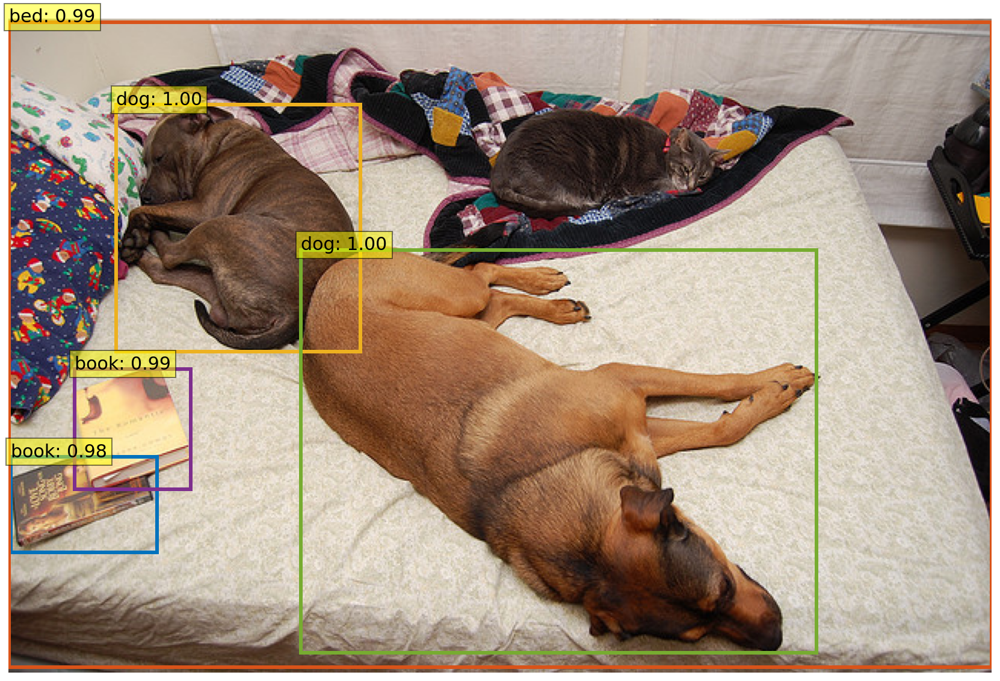

In [25]:
url = 'http://images.cocodataset.org/val2017/000000071226.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (640, 480)


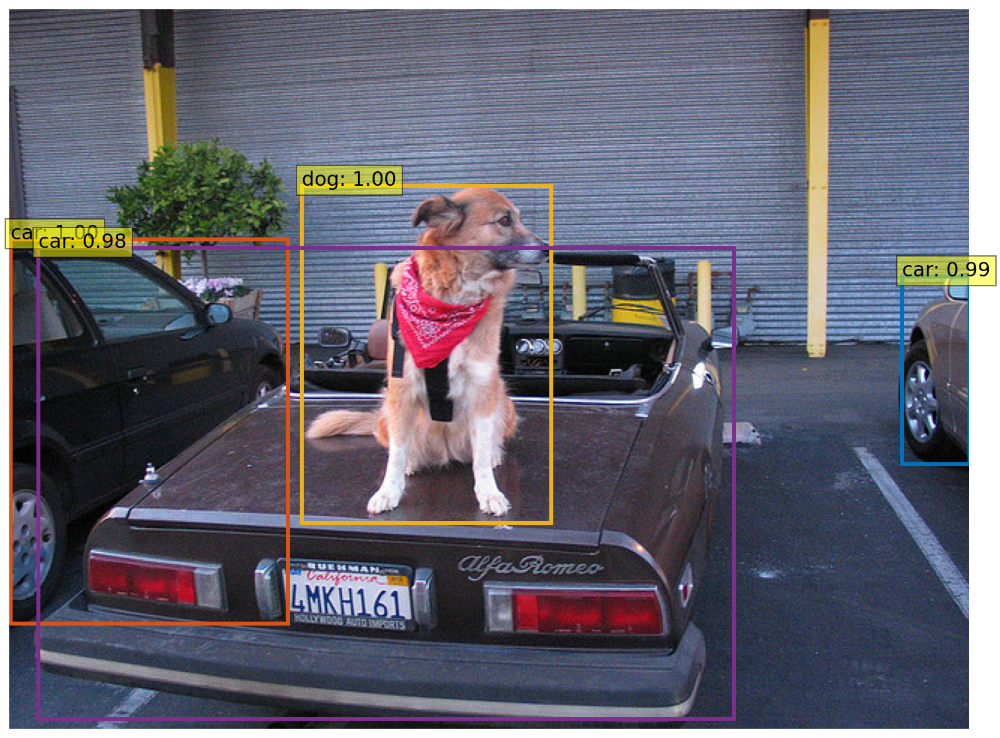

In [26]:
url = 'http://images.cocodataset.org/val2017/000000078823.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (640, 427)


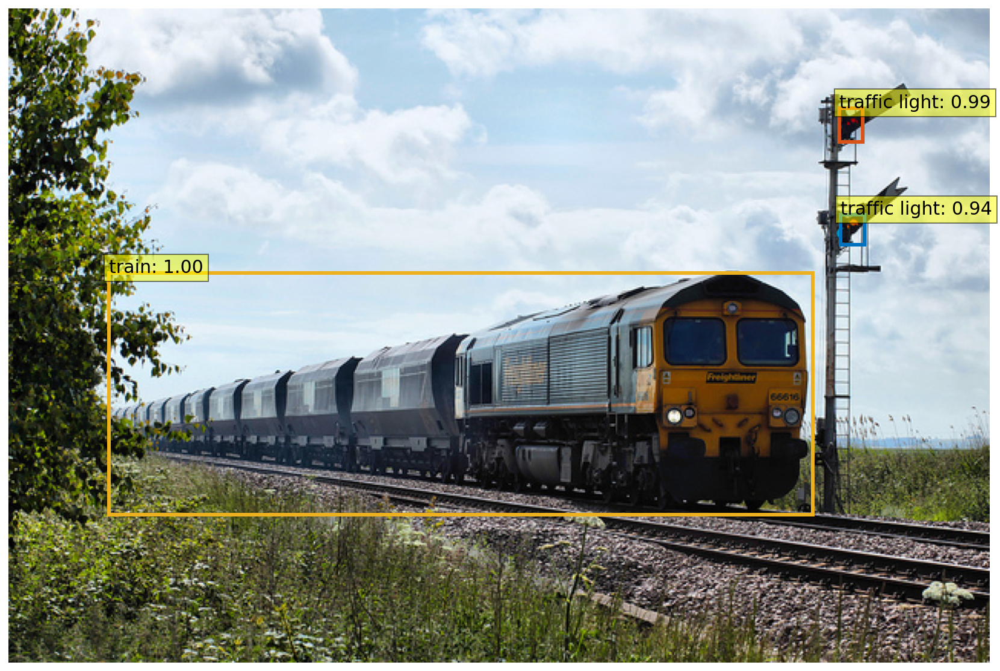

In [27]:
url = 'http://images.cocodataset.org/val2017/000000090155.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

#### Inference on Pascal VOC test dataset images

im:  (500, 249)


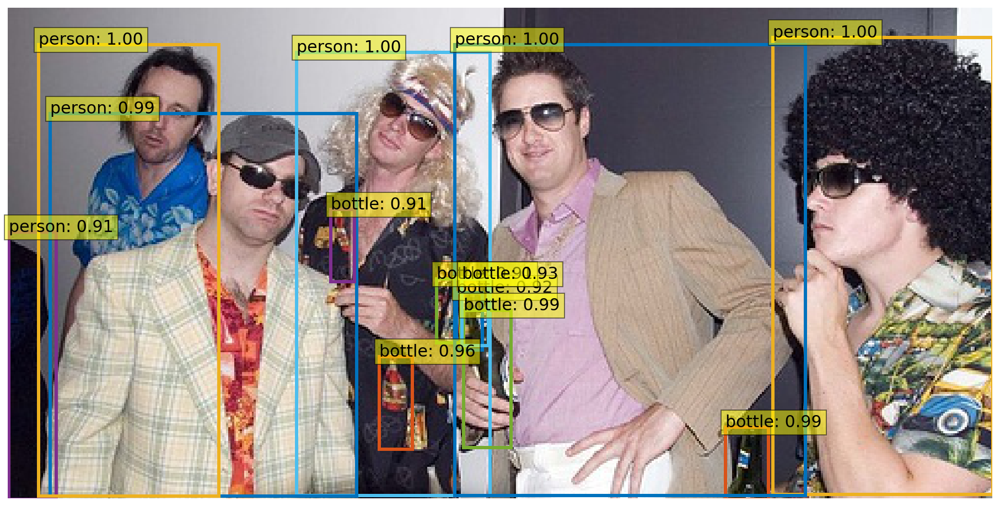

In [28]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\000200.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (500, 459)


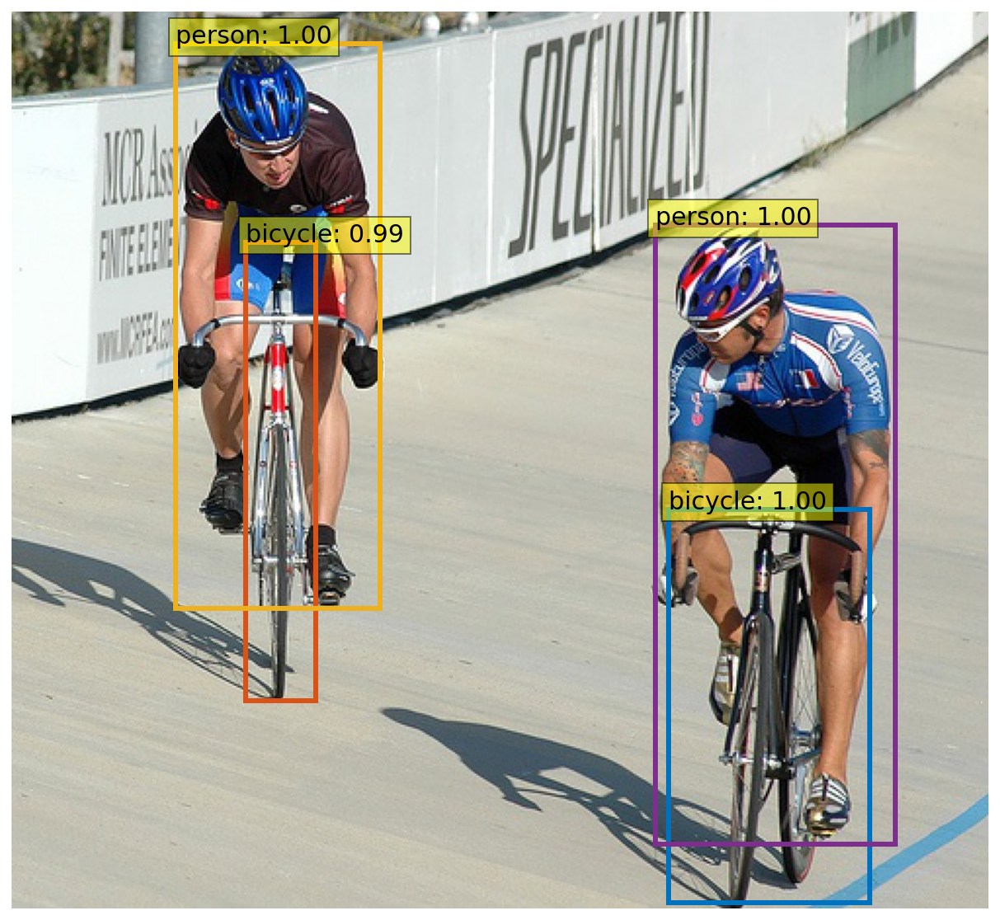

In [29]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\000283.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (500, 337)


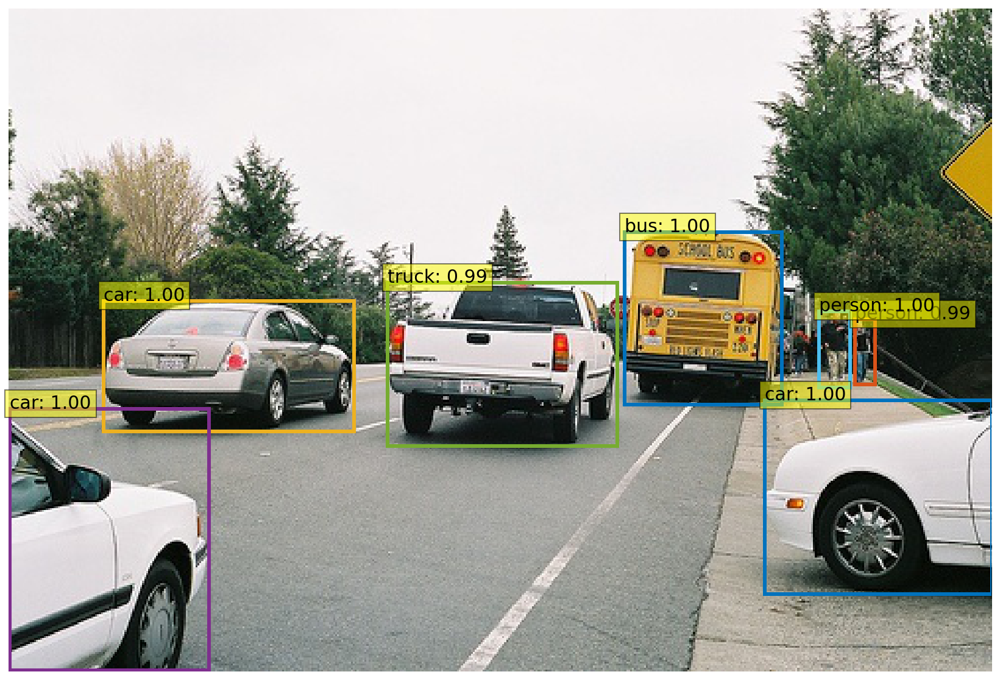

In [30]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\000341.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (375, 500)


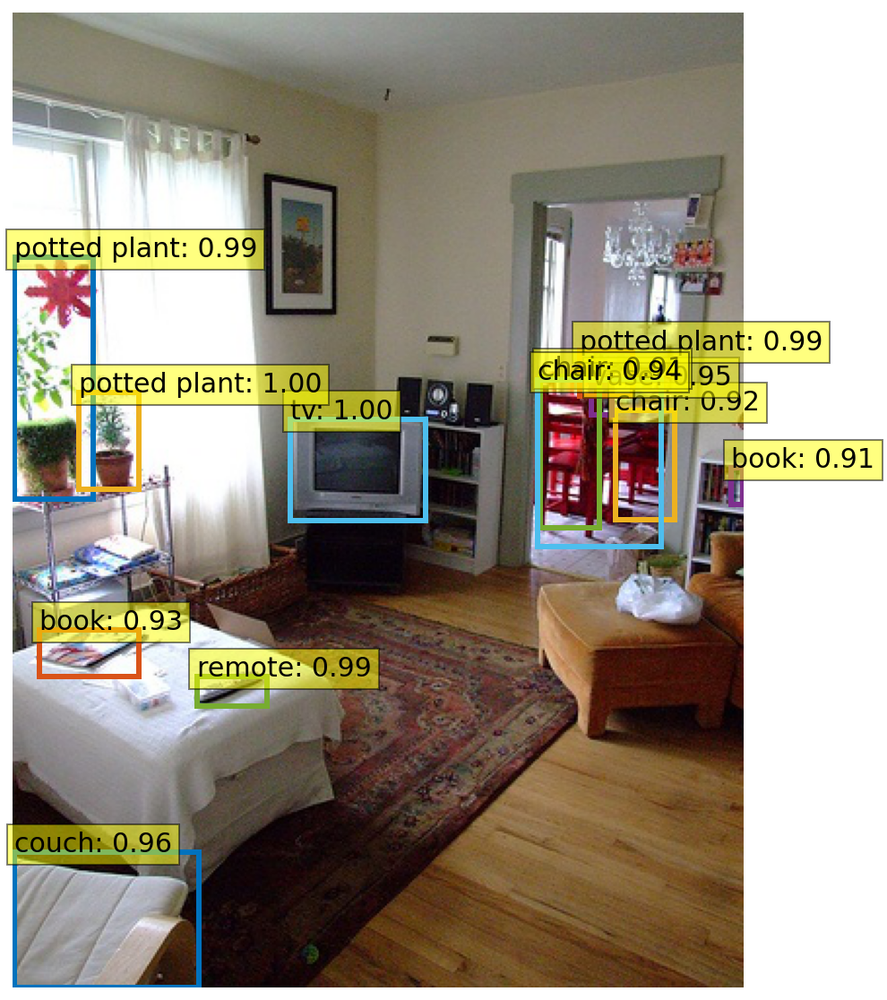

In [31]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\000397.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (500, 302)


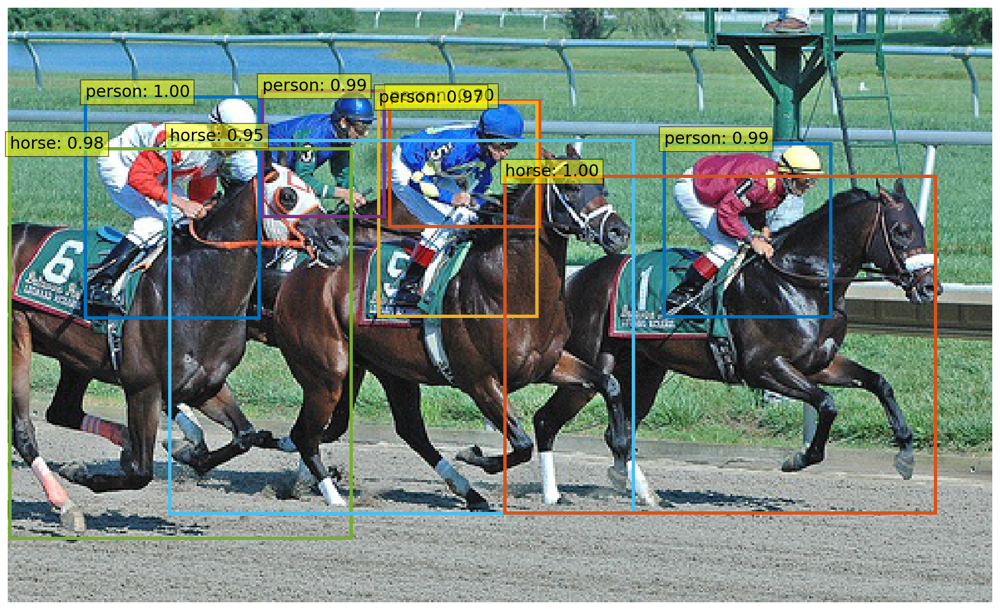

In [32]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\000445.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (500, 375)


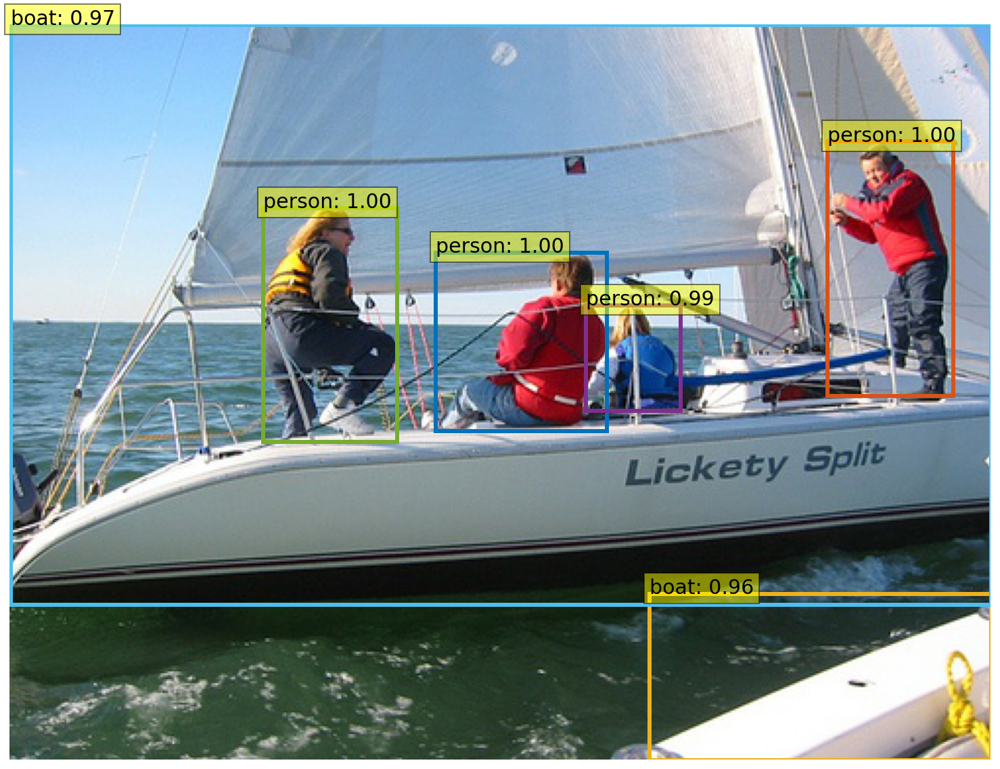

In [33]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\000449.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

im:  (500, 333)


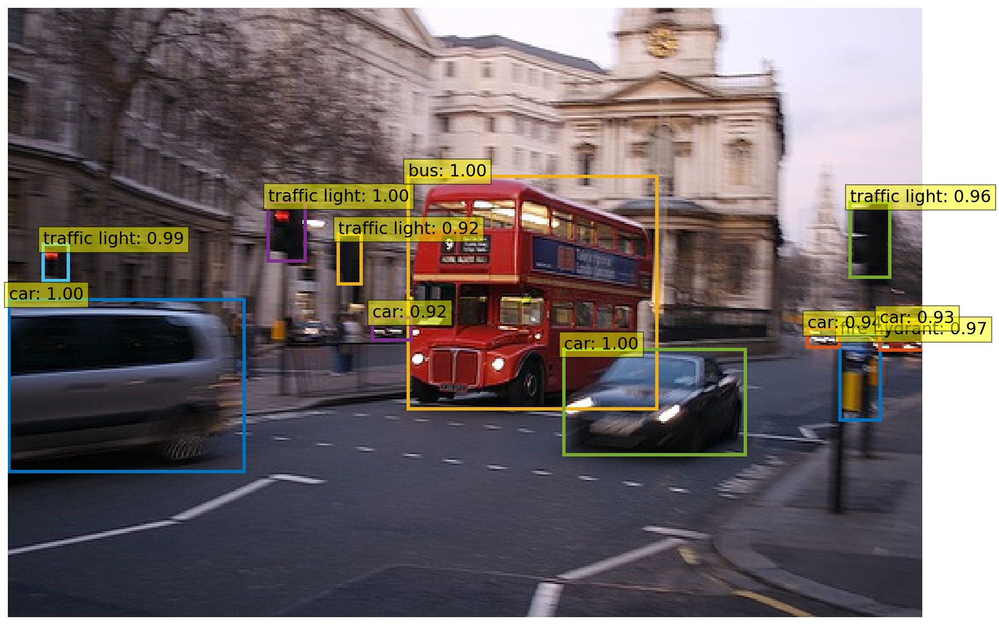

In [34]:
im = Image.open(r"C:\an4\licenta\datasets\PascalVOC\VOCdevkit\VOC07_12\val2017\008488.jpg")
print("im: ", im.size)

scores, boxes = detect(im, model, transform, 0.9)
plot_results(im, scores, boxes)

## Visualize encoder-decoder multi-head attention weights

-   visualise attention weights of the last decoder layer
-   i.e. visualise, for each detected object, where the model is looking to predict the class and bounding box

im:  (640, 480)


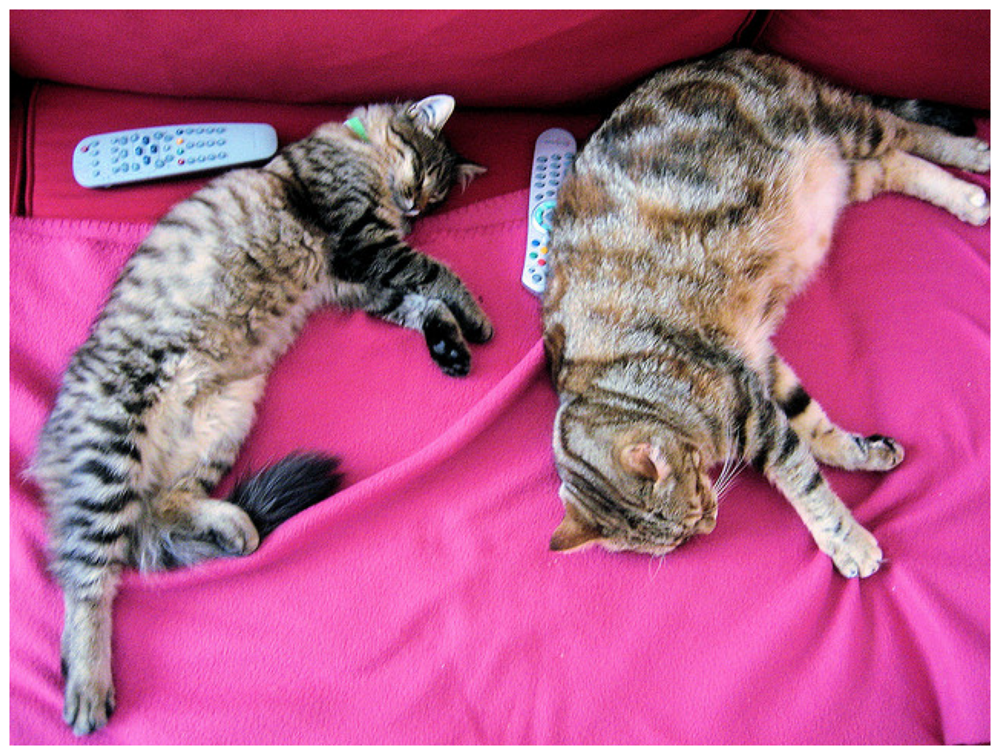

In [66]:
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

plot_image(im)

# mean-std normalize the input image (batch-size: 1)
img = transform(im).unsqueeze(0)

# propagate through the model
outputs = model(img)

# keep only predictions with 0.7+ confidence
probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
keep = probas.max(-1).values > 0.9

# convert boxes from [0; 1] to image scales
bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

In [67]:
# use lists to store the outputs via up-values
conv_features, enc_attn_weights, dec_attn_weights, dec_self_attn_weights, dec_self_attn_out = [], [], [], [], []

# use hooks to extract attention weights
hooks = [
    model.backbone[-2].register_forward_hook(
        lambda self, input, output: conv_features.append(output)
    ),
    model.transformer.encoder.layers[-1].self_attn.register_forward_hook(
        lambda self, input, output: enc_attn_weights.append(output[1])
    ),
    model.transformer.decoder.layers[-1].multihead_attn.register_forward_hook(
        lambda self, input, output: dec_attn_weights.append(output[1])
    ),
    model.transformer.decoder.layers[-1].self_attn.register_forward_hook(
        lambda self, input, output: dec_self_attn_weights.append(output[1])
    ),
    model.transformer.decoder.layers[-1].self_attn.register_forward_hook(
        lambda self, input, output: dec_self_attn_out.append(output[0])
    ),
]

# propagate through the model
outputs = model(img)

for hook in hooks:
    hook.remove()
    
# don't need the list anymore
conv_features = conv_features[0]
enc_attn_weights = enc_attn_weights[0]
dec_attn_weights = dec_attn_weights[0]
dec_self_attn_weights = dec_self_attn_weights[0]
dec_self_attn_out = dec_self_attn_out[0]

### Decoder self-attention weights

torch.Size([8, 100, 100])


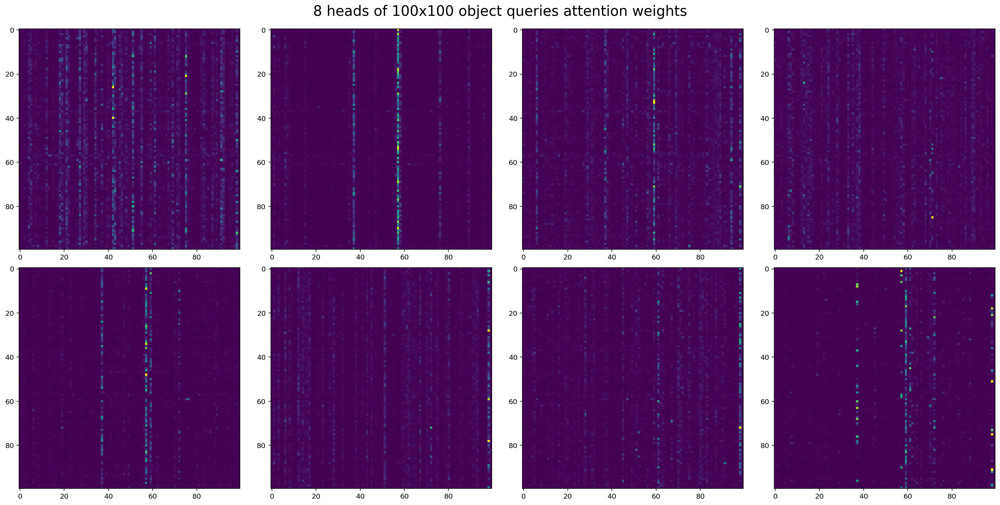

In [68]:
print(dec_self_attn_weights.shape)

fig, axs = plt.subplots(ncols=4, nrows=2, figsize=(20, 10))
fig.suptitle('8 heads of 100x100 object queries attention weights', y=0.99, fontsize=20)
for i in range(2):
    for j in range(4):
        axs[i, j].imshow(dec_self_attn_weights[4*i+j, :, :])
#         axs[i, j].axis('off')
fig.tight_layout()

### Decoder self-attention outputs

torch.Size([100, 1, 256])


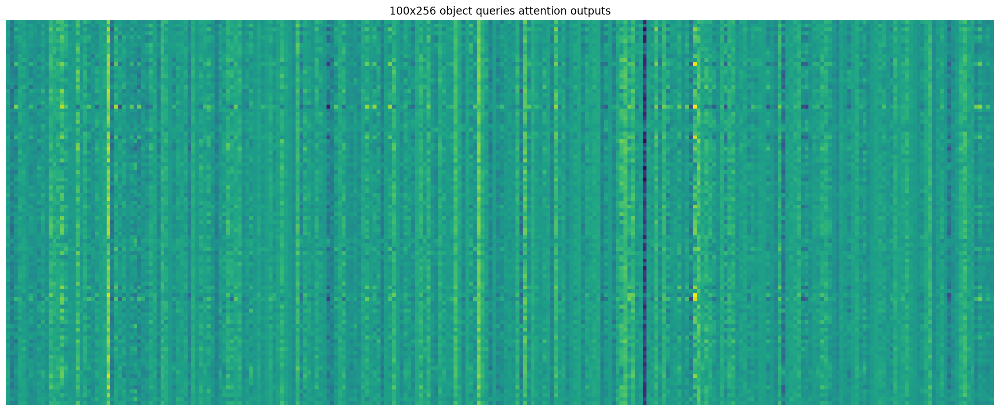

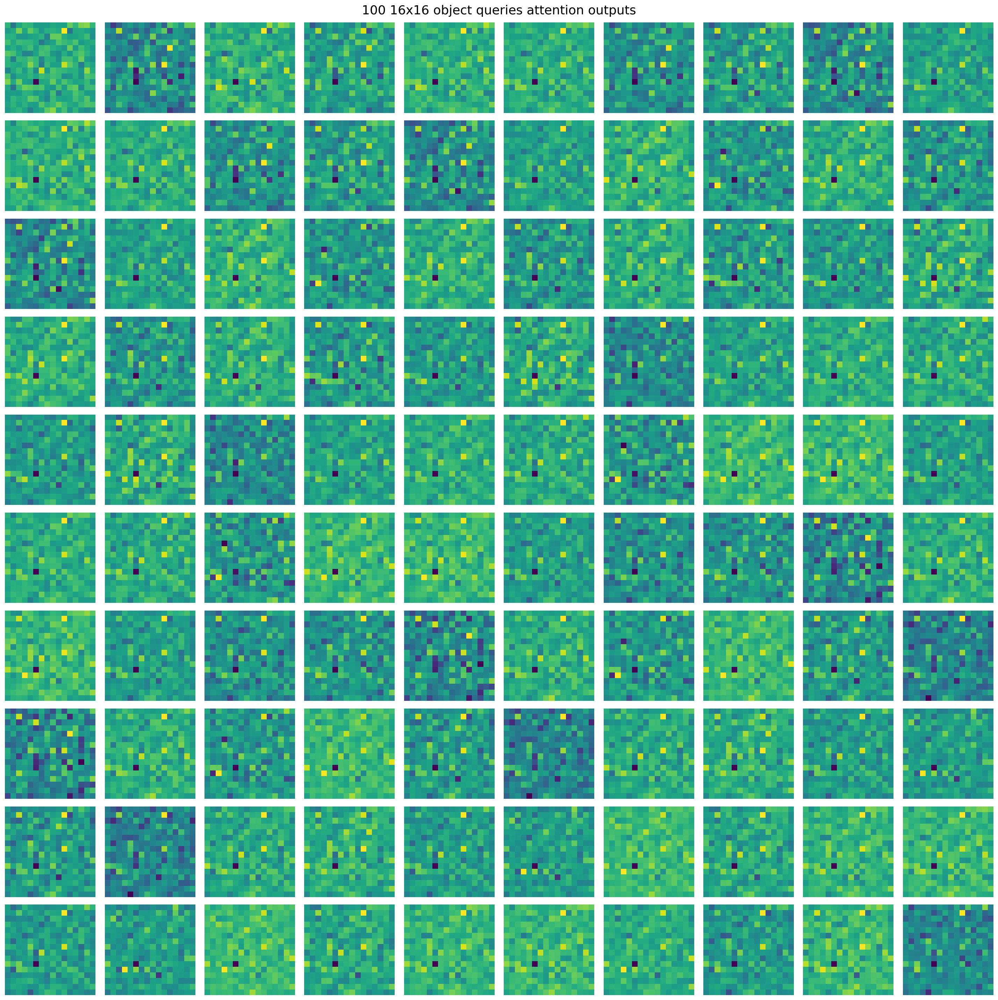

In [69]:
print(dec_self_attn_out.shape)

plt.figure(figsize=(20,10))
plt.axis('off')
plt.imshow(dec_self_attn_out[:, 0, :])
plt.title('100x256 object queries attention outputs')

fig, axs = plt.subplots(ncols=10, nrows=10, figsize=(20, 20))
fig.suptitle('100 16x16 object queries attention outputs', y=0.99, fontsize=18)
for i in range(10):
    for j in range(10):
        axs[i, j].imshow(dec_self_attn_out[4*i+j, 0].view(16, 16))
        axs[i, j].axis('off')
fig.tight_layout()

### Decoder multi-head attention weights

torch.Size([8, 100, 850])


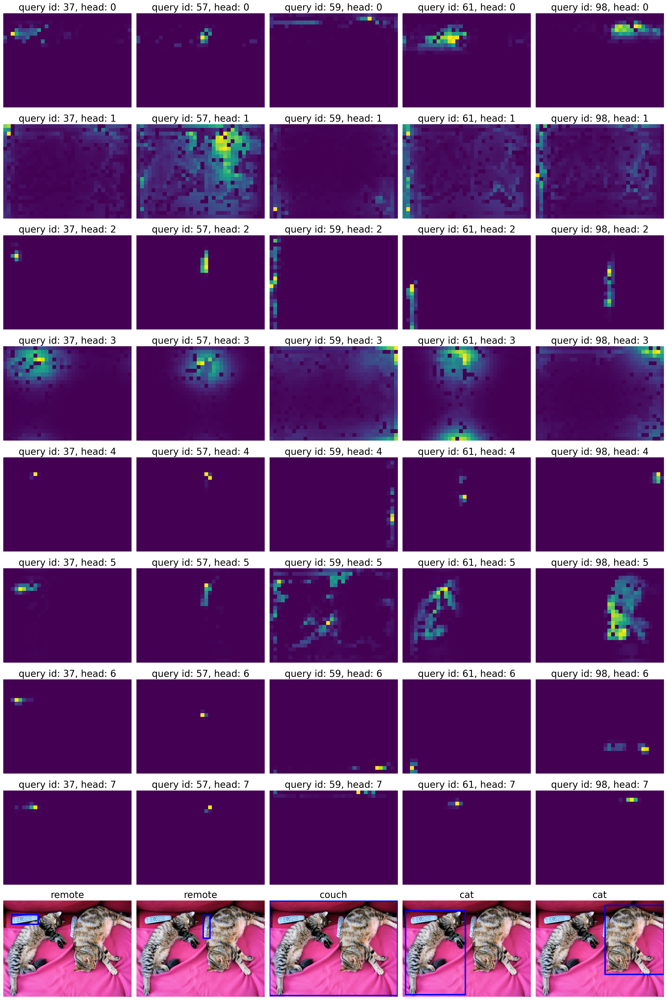

In [70]:
# get the feature map shape
h, w = conv_features['0'].tensors.shape[-2:]

print(dec_attn_weights.shape)

fig, axs = plt.subplots(ncols=len(bboxes_scaled), nrows=9, figsize=(20, 30))
colors = COLORS * 100
for idx, ax_i, (xmin, ymin, xmax, ymax) in zip(keep.nonzero(), axs.T, bboxes_scaled):
    for i in range(8):
        ax = ax_i[i]
        ax.imshow(dec_attn_weights[i, idx].view(h, w))
        ax.axis('off')
        ax.set_title(f'query id: {idx.item()}, head: {i}', fontsize=20)
    
    ax = ax_i[8]
    ax.imshow(im)
    ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                               fill=False, color='blue', linewidth=3))
    ax.axis('off')
    ax.set_title(CLASSES[probas[idx].argmax()], fontsize=20)
fig.tight_layout()

## Visualize encoder self-attention weights

In [71]:
# output of the CNN
f_map = conv_features['0']
print("Encoder attention:      ", enc_attn_weights[0].shape)
print("Feature map:            ", f_map.tensors.shape)

# get the HxW shape of the feature maps of the CNN
shape = f_map.tensors.shape[-2:]
# and reshape the self-attention to a more interpretable shape
sattn = enc_attn_weights[0].reshape(shape + shape)
print("Reshaped self-attention:", sattn.shape)

print(enc_attn_weights.shape)

Encoder attention:       torch.Size([850, 850])
Feature map:             torch.Size([1, 2048, 25, 34])
Reshaped self-attention: torch.Size([25, 34, 25, 34])
torch.Size([8, 850, 850])


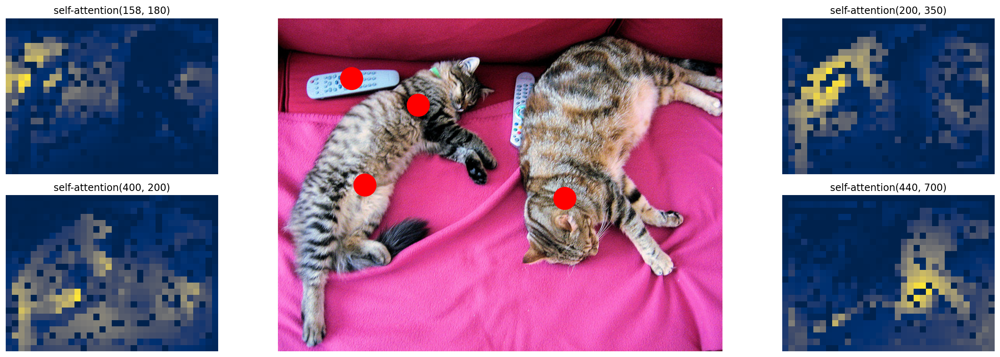

In [82]:
sattn = enc_attn_weights[0].reshape(shape + shape)

# downsampling factor for the CNN, is 32 for DETR and 16 for DETR DC5
fact = 32

# let's select 4 reference points for visualization
idxs = [(158, 180), (400, 200), (200, 350), (440, 700),]

# here we create the canvas
fig = plt.figure(constrained_layout=True, figsize=(25 * 0.7, 8.5 * 0.7))
# and we add one plot per reference point
gs = fig.add_gridspec(2, 4)
axs = [
    fig.add_subplot(gs[0, 0]),
    fig.add_subplot(gs[1, 0]),
    fig.add_subplot(gs[0, -1]),
    fig.add_subplot(gs[1, -1]),
]

# for each one of the reference points, let's plot the self-attention
# for that point
for idx_o, ax in zip(idxs, axs):
    idx = (idx_o[0] // fact, idx_o[1] // fact)
    ax.imshow(sattn[..., idx[0], idx[1]], cmap='cividis', interpolation='nearest')
    ax.axis('off')
    ax.set_title(f'self-attention{idx_o}')

# and now let's add the central image, with the reference points as red circles
fcenter_ax = fig.add_subplot(gs[:, 1:-1])
fcenter_ax.imshow(im)
for (y, x) in idxs:
    scale = im.height / img.shape[-2]
    x = ((x // fact) + 0.5) * fact
    y = ((y // fact) + 0.5) * fact
    fcenter_ax.add_patch(plt.Circle((x * scale, y * scale), fact // 2, color='r'))
    fcenter_ax.axis('off')

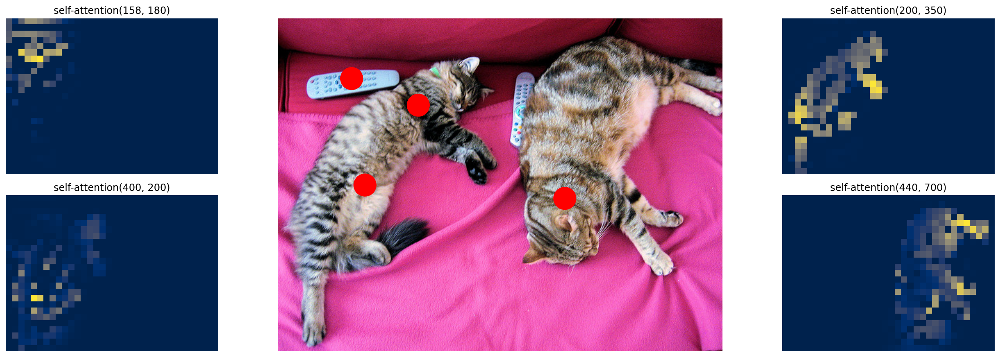

In [86]:
sattn = enc_attn_weights[7].reshape(shape + shape)

# downsampling factor for the CNN, is 32 for DETR and 16 for DETR DC5
fact = 32

# let's select 4 reference points for visualization
idxs = [(158, 180), (400, 200), (200, 350), (440, 700),]

# here we create the canvas
fig = plt.figure(constrained_layout=True, figsize=(25 * 0.7, 8.5 * 0.7))
# and we add one plot per reference point
gs = fig.add_gridspec(2, 4)
axs = [
    fig.add_subplot(gs[0, 0]),
    fig.add_subplot(gs[1, 0]),
    fig.add_subplot(gs[0, -1]),
    fig.add_subplot(gs[1, -1]),
]

# for each one of the reference points, let's plot the self-attention
# for that point
for idx_o, ax in zip(idxs, axs):
    idx = (idx_o[0] // fact, idx_o[1] // fact)
    ax.imshow(sattn[..., idx[0], idx[1]], cmap='cividis', interpolation='nearest')
    ax.axis('off')
    ax.set_title(f'self-attention{idx_o}')

# and now let's add the central image, with the reference points as red circles
fcenter_ax = fig.add_subplot(gs[:, 1:-1])
fcenter_ax.imshow(im)
for (y, x) in idxs:
    scale = im.height / img.shape[-2]
    x = ((x // fact) + 0.5) * fact
    y = ((y // fact) + 0.5) * fact
    fcenter_ax.add_patch(plt.Circle((x * scale, y * scale), fact // 2, color='r'))
    fcenter_ax.axis('off')